In [75]:
from copy import deepcopy
from tqdm import tqdm
import random
from collections import defaultdict
import os
import sys
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import json

# Add the `src` folder to the Python path
sys.path.append(os.path.join(os.path.abspath('..'), 'src'))
import environment

In [40]:
# TD class with states represented with integers
class TemporalDifference:
    def __init__(self, oiv = 0, alpha=0.1, epsilon=0.1, lambd=0.9, gamma=0.9):
        """
        Args:
        - lanes (int): Number of lanes (default is 5).
        - initial_distance (int): The distance from destination.
        - alpha (float): learning rate, between 0 and 1
        - epsilon (float): exploration rate between, 0 and 1
        - lambd (float): contribution of past rewards, between 0 and 1
        - gamma (float): discount factor, between 0 and 1
        - oiv (int/float): optimistic initial value
        """
        super().__init__()
        self.Env = environment.TrafficEnvironment()
        self.alpha = alpha
        self.epsilon = epsilon
        self.lambd = lambd
        self.gamma = gamma
        self.oiv = oiv

        # Action space: 3 actions (0: move left, 1: stay, 2: move right)
        self.action_space = 3

        # use nested dictionaries for Q, E.
        # {state: [s_a1, s_a2, s_a3]}
        self.Q = defaultdict(lambda: np.zeros(self.action_space) + self.oiv)
        self.E = defaultdict(lambda: np.zeros(self.action_space) + self.oiv)

        # store 'best model'
        self.best_Q = None
        self.best_reward = float('-inf')

    def get_best_action(self, state: tuple):
        # if state not present, act random
        if state not in self.Q.keys():
            return random.randint(0,self.action_space-1)

        # get the dictionary of actions and their values for this state
        action_values = self.Q[state]
        # find the action with the maximum value
        best_action = np.argmax(action_values)
        return best_action

    # define epsilon greedypolicy
    def epsilon_greedy_policy(self, state):
        if np.random.rand() < self.epsilon:
            return random.randint(0,self.action_space-1)
        else:
            return self.get_best_action(state)
    
    def transform_state(self, state, num_discrete_levels=5):
            """
            Normalize the distance to a percentage of the initial distance and discretize clearance rates.
            
            Args:
            - state: The original state tuple from the environment.
            - initial_distance: Initial distance to the destination for normalizing distance.
            - num_discrete_levels: Number of discrete levels for clearance rates.

            Returns:
            - transformed_state: Tuple containing the normalized distance percentage and discrete clearance rates.
            """
            # Normalize distance as a percentage of initial distance
            distance_percentage = int((state[14] / self.Env.initial_distance) * 10)
            
            # Get current lane and clearance rates for adjacent lanes
            current_lane = int(state[15])
            clearance_rates = state[16:]
            
            # Discretize clearance rates to specified levels (e.g., 1 to 10)
            min_rate, max_rate = 5, max(20, max(clearance_rates))
            left_lane_rate = (clearance_rates[current_lane - 1] if current_lane > 1 else None)
            right_lane_rate = (clearance_rates[current_lane] if current_lane < len(clearance_rates) else None)
            current_lane_rate = clearance_rates[current_lane - 1]
            
            # Discretize clearance rates within the specified range
            def discretize_rate(rate):
                if rate is None:
                    return 0  # Assign 0 if no lane exists (e.g., left lane when in the leftmost position)
                return int((rate - min_rate) / (max_rate - min_rate) * (num_discrete_levels - 1)) + 1

            left_lane_rate = discretize_rate(left_lane_rate)
            right_lane_rate = discretize_rate(right_lane_rate)
            current_lane_rate = discretize_rate(current_lane_rate)

            # Return transformed state with normalized distance and discrete clearance rates
            return (distance_percentage, current_lane, current_lane_rate, left_lane_rate, right_lane_rate)

    def train(self, num_episodes = 1000 , on_policy = True, save_model = False):

        #initialize list to store episode history
        self.total_reward_list = []
        self.total_steps_list = []
        truncated_count = 0

        for episode in tqdm(range(num_episodes)):
            episode_memory = []  # to be used when lambd = 1
            
            #reset episode, re-initialize E and total_reward
            state = self.Env.reset()
            flattened_state = tuple(item for tup in state for item in tup)
            state = self.transform_state(flattened_state)

            terminated = False
            truncated = False
            self.E.clear()
            steps = 0
            total_reward = 0

            #get first action
            action = self.epsilon_greedy_policy(state)

            # if log:
            #     self.Env.render()
            #     self.Env.logger.info(f"Action: {action}")

            while not terminated and not truncated:
                #perform action
                next_state, reward, terminated = self.Env.step(action)
                flattened_next_state = tuple(item for tup in next_state for item in tup)

                next_state = self.transform_state(flattened_next_state)

                #accumulate steps and reward
                steps += 1
                total_reward += reward

                #get next state and action
                next_action = self.epsilon_greedy_policy(next_state)
                
                #update tables(dictionaries)
                if self.lambd == 1:
                    episode_memory.append([state, action, reward])
                    state, action = next_state, next_action
                    state = tuple(state)
                    continue

                if on_policy:   # SARSA
                    delta = reward + self.gamma * (not terminated) * self.Q[next_state][next_action] - self.Q[state][action]
                else:           # Q-learning
                    best_next_action = self.get_best_action(next_state)
                    delta = reward + self.gamma * (not terminated) * self.Q[next_state][best_next_action] - self.Q[state][action]
                
                # if TD(0), no need to perform epsilon decay
                if self.lambd == 0:
                    # update Q values
                    self.Q[state][action] += self.alpha * delta
                
                # if TD(lambd), update E & Q
                else:
                    self.E[state][action] += 1
                    for state in self.Q.keys():
                        for action in range(self.action_space):
                            self.Q[state][action] += self.alpha * delta * self.E[state][action]
                            self.E[state][action] *= self.gamma * self.lambd
                if truncated:
                    truncated_count += 1

                if terminated:
                    break

                # move to next state and action pair
                state, action = next_state, next_action
                                
                # if log:
                #     self.Env.render()
                #     self.Env.logger.info(f"Action: {action}")
            
            # Append total rewards and steps after the episode ends
            self.total_reward_list.append(reward)
            self.total_steps_list.append(steps)
            
            if save_model == True:
                # Calculate average reward over last 100 episodes (or all if less than 100)
                window_size = min(100, len(self.total_reward_list))
                avg_reward = sum(self.total_reward_list[-window_size:]) / window_size
                
                # Save if best performance
                if avg_reward > self.best_reward:
                    self.best_reward = avg_reward
                    self.best_Q = dict(self.Q)  # Create a deep copy of current Q-values
                
            if self.lambd == 1:
                G = 0
                for state, action, reward in reversed(episode_memory):
                    G = reward + self.gamma * G
                    self.Q[state][action] += self.alpha * (G - self.Q[state][action])

        if episode % 1000 == 0:
            print(f'Sum of rewards at episode {episode} is {reward}' )

        return self.total_reward_list, self.total_steps_list

##### **Visualise training**

In [41]:
def plot_training_metrics(rewards, steps, window_size=50):
    """
    Plot training metrics (rewards and steps) with rolling mean (window_size)
    
    Args:
    rewards: list of episode rewards
    steps: list of episode steps
    window_size: size of rolling window for smoothing
    """
    # Create figure with two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    
    # Create dataframes for easier plotting
    df_rewards = pd.DataFrame({
        'Episode': range(len(rewards)),
        'Reward': rewards,
        'Rolling Mean': pd.Series(rewards).rolling(window=window_size).mean()
    })
    
    df_steps = pd.DataFrame({
        'Episode': range(len(steps)),
        'Steps': steps,
        'Rolling Mean': pd.Series(steps).rolling(window=window_size).mean()
    })
    
    # Plot rewards
    sns.scatterplot(data=df_rewards, x='Episode', y='Reward', 
                   alpha=0.3, color='blue', ax=ax1, label='Reward')
    sns.lineplot(data=df_rewards, x='Episode', y='Rolling Mean',
                color='red', ax=ax1, linewidth=2, label=f'Rolling Mean (window={window_size})')
    ax1.set_title('Rewards per Episode')
    ax1.set_xlabel('Episode')
    ax1.set_ylabel('Total Reward')
    
    # Plot steps
    sns.scatterplot(data=df_steps, x='Episode', y='Steps',
                   alpha=0.3, color='blue', ax=ax2, label='Steps')
    sns.lineplot(data=df_steps, x='Episode', y='Rolling Mean',
                color='red', ax=ax2, linewidth=2, label=f'Rolling Mean (window={window_size})')
    ax2.set_title('Steps per Episode')
    ax2.set_xlabel('Episode')
    ax2.set_ylabel('Number of Steps')
    
    # Adjust layout and display
    plt.tight_layout()
    return fig

In [62]:
def train_model(num_iterations = 3, num_episodes = 1000, on_policy = True, alpha=0.1, epsilon=0.1, lambd=0, gamma=0.9):
    iteration_rew = []
    iteration_avg_rew = []
    iteration_avg_steps = []
    for i in range(num_iterations):
        sarsa = TemporalDifference(oiv = 0, alpha=alpha, epsilon=epsilon, lambd=lambd, gamma=gamma)
        total_reward_list, total_steps_list = sarsa.train(num_episodes = num_episodes, on_policy = on_policy, save_model = False)
        total_rew = sum(total_reward_list)
        avg_rew = np.mean(total_reward_list)
        avg_steps = np.mean(total_steps_list)

        iteration_rew.append(total_rew)
        iteration_avg_rew.append(avg_rew)
        iteration_avg_steps.append(avg_steps)

        print(f'At iteration {i+1}')
        print(f'State-size = {len(sarsa.Q)}')
        print(f'Sum of total rewards = {total_rew}')
        print(f'Average total reward per episode = {avg_rew}')
        print(f'Average steps per episode = {avg_steps}')

        # plot training metrics
        plot_training_metrics(total_reward_list, total_steps_list, window_size=50)
        plt.show()
        
    print("\nAverage result per iteration")
    print(f'Sum of total rewards = {np.mean(iteration_rew)}')
    print(f'Average total reward per episode = {np.mean(iteration_avg_rew)}')
    print(f'Average steps per episode = {np.mean(iteration_avg_steps)}')

In [ ]:
# saving q table into json
def save_q_val(file_path, q_values): #input file path & Q table
    # Convert tuple keys to strings
    q_values_serializable = {str(key): value.tolist() if isinstance(value, np.ndarray) else value 
                             for key, value in q_values.items()}
    
    # Save the dictionary as a JSON file
    with open(file_path, "w") as json_file:
        json.dump(q_values_serializable, json_file)

#### SARSA

100%|██████████| 1000/1000 [00:42<00:00, 23.57it/s]


At iteration 1
State-size = 346
Sum of total rewards = 468.8999999999991
Average total reward per episode = 0.4689
Average steps per episode = 1021.339


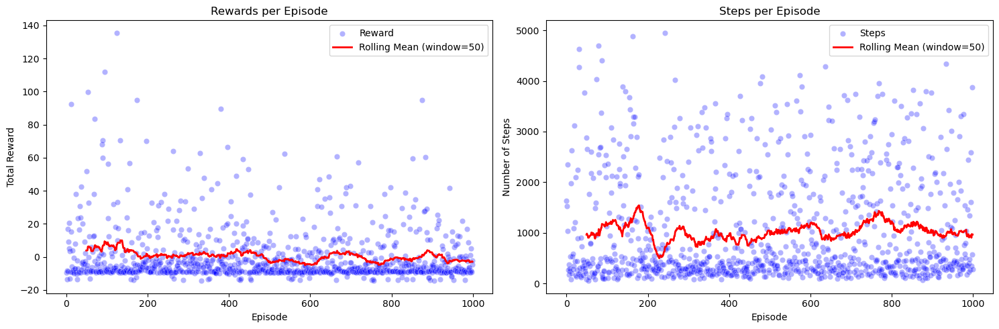

100%|██████████| 1000/1000 [00:42<00:00, 23.60it/s]


At iteration 2
State-size = 411
Sum of total rewards = 661.7000000000005
Average total reward per episode = 0.6617000000000002
Average steps per episode = 1070.573


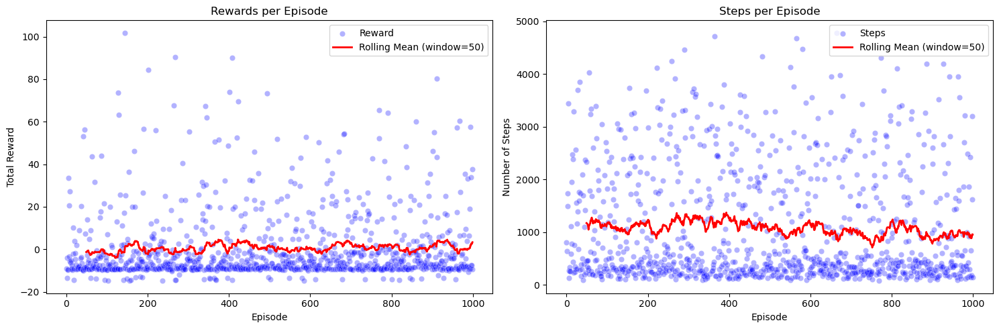

100%|██████████| 1000/1000 [00:39<00:00, 25.31it/s]


At iteration 3
State-size = 372
Sum of total rewards = 1417.9999999999998
Average total reward per episode = 1.418
Average steps per episode = 1008.081


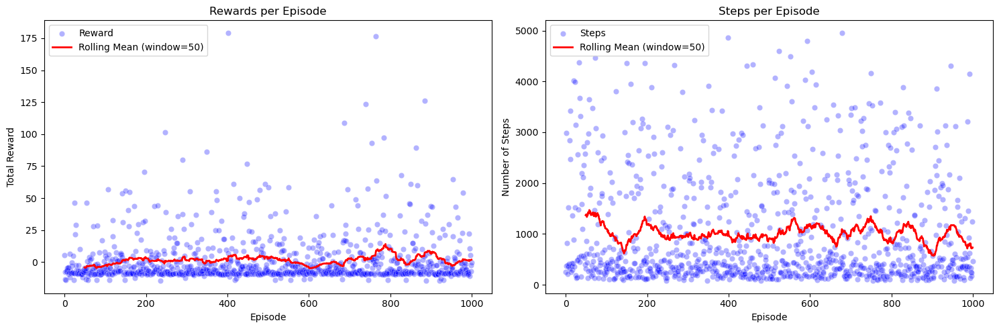


Average result per iteration
Sum of total rewards = 849.5333333333332
Average total reward per episode = 0.8495333333333335
Average steps per episode = 1033.3310000000001


In [ ]:
# SARSA
train_model(num_iterations = 3, num_episodes = 1000, on_policy = True, alpha=0.1, epsilon=0.1, lambd=0, gamma=0.9) # SARSA

100%|██████████| 5000/5000 [04:35<00:00, 18.12it/s]


At iteration 1
State-size = 532
Sum of total rewards = 2352.400000000005
Average total reward per episode = 0.47047999999999995
Average steps per episode = 1019.5334


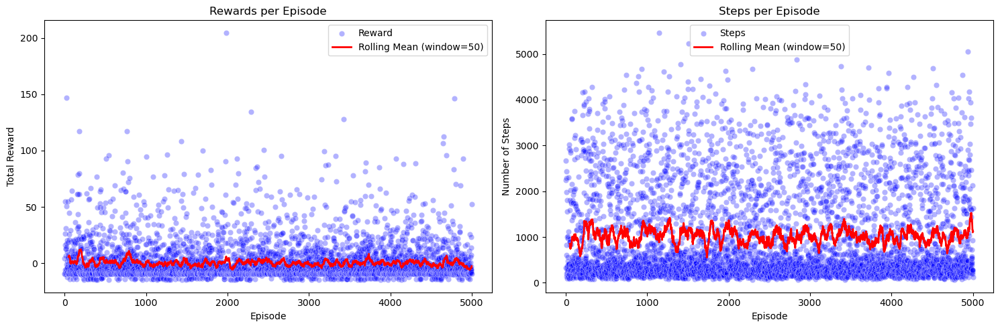

100%|██████████| 5000/5000 [04:38<00:00, 17.94it/s]


At iteration 2
State-size = 524
Sum of total rewards = 2001.6000000000045
Average total reward per episode = 0.40032
Average steps per episode = 1017.811


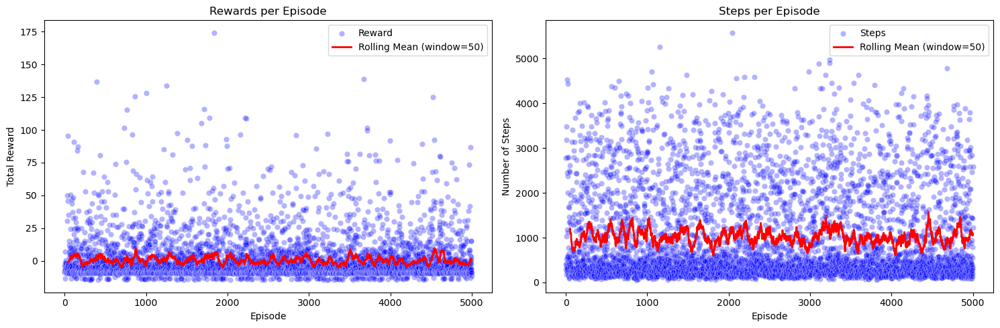

100%|██████████| 5000/5000 [04:42<00:00, 17.73it/s]


At iteration 3
State-size = 559
Sum of total rewards = 2936.899999999992
Average total reward per episode = 0.5873799999999999
Average steps per episode = 1035.144


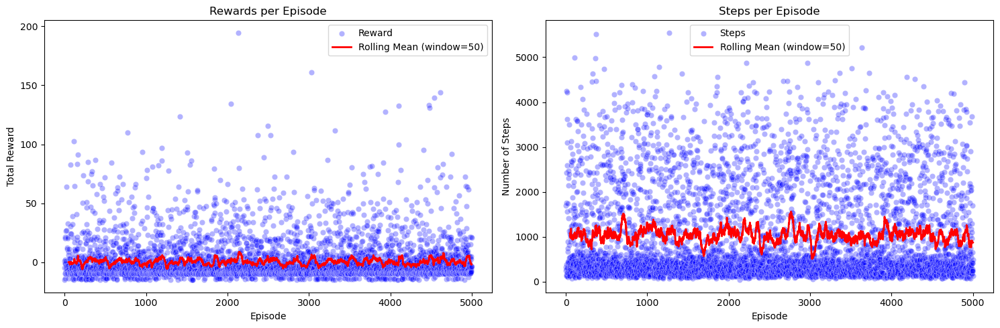


Average result per iteration
Sum of total rewards = 2430.3000000000006
Average total reward per episode = 0.48606
Average steps per episode = 1024.1628


In [64]:
# SARSA
train_model(num_iterations = 3, num_episodes = 5000, on_policy = True, alpha=0.1, epsilon=0.1, lambd=0, gamma=0.9) # SARSA

#### Search alpha & gamma



--------------------Hyperparameters alpha = 0.1, gamma = 0.9--------------------


100%|██████████| 10000/10000 [08:56<00:00, 18.65it/s]


At iteration 1
State-size = 520
Sum of total rewards = 6297.900000000012
Average total reward per episode = 0.62979
Average steps per episode = 990.609


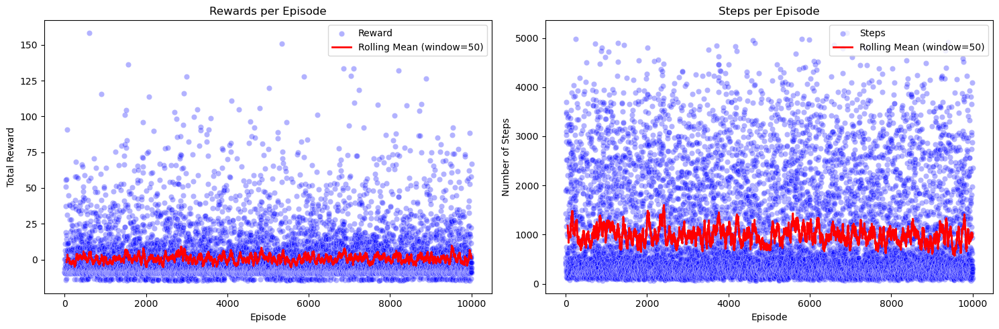

100%|██████████| 10000/10000 [08:52<00:00, 18.78it/s]


At iteration 2
State-size = 657
Sum of total rewards = 6119.000000000007
Average total reward per episode = 0.6119000000000001
Average steps per episode = 993.4129


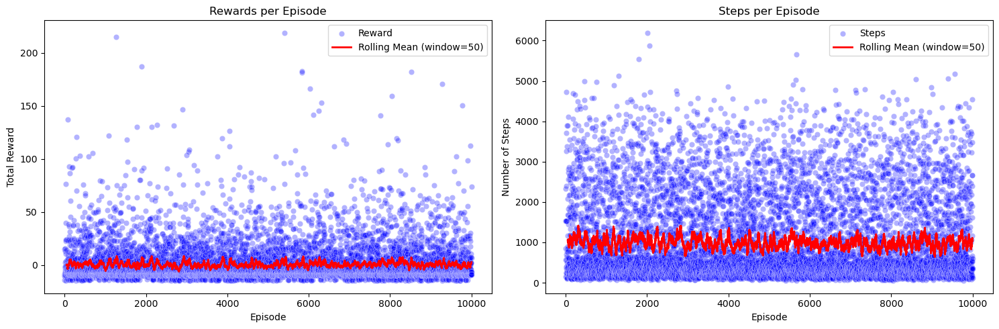

100%|██████████| 10000/10000 [09:00<00:00, 18.50it/s]


At iteration 3
State-size = 556
Sum of total rewards = 5721.500000000008
Average total reward per episode = 0.57215
Average steps per episode = 1015.852


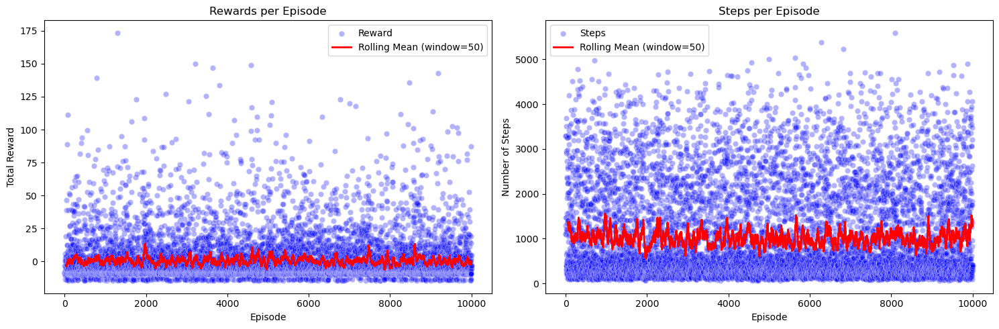


Average result per iteration
Sum of total rewards = 6046.133333333342
Average total reward per episode = 0.6046133333333334
Average steps per episode = 999.9579666666667


--------------------Hyperparameters alpha = 0.1, gamma = 0.95--------------------


100%|██████████| 10000/10000 [09:01<00:00, 18.45it/s]


At iteration 1
State-size = 648
Sum of total rewards = 4375.500000000001
Average total reward per episode = 0.43755
Average steps per episode = 1012.2027


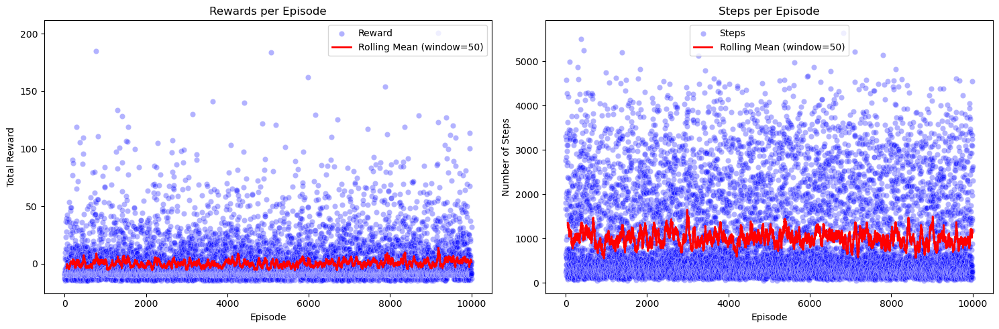

100%|██████████| 10000/10000 [09:07<00:00, 18.25it/s]


At iteration 2
State-size = 688
Sum of total rewards = 4808.900000000011
Average total reward per episode = 0.48089000000000004
Average steps per episode = 1002.1435


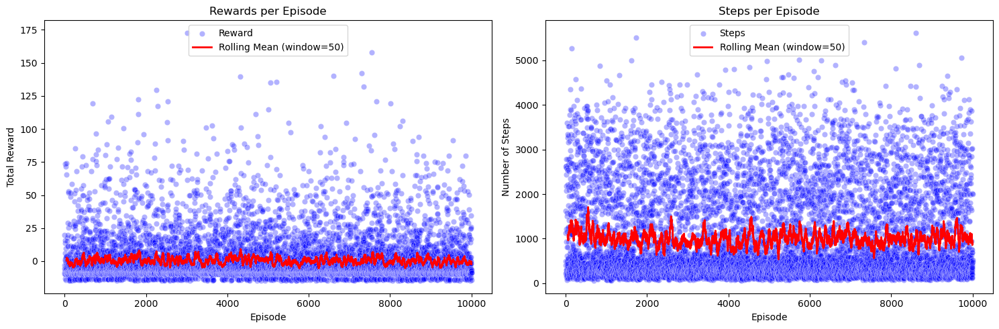

100%|██████████| 10000/10000 [08:50<00:00, 18.84it/s]


At iteration 3
State-size = 695
Sum of total rewards = 2666.5000000000077
Average total reward per episode = 0.2666500000000001
Average steps per episode = 1015.2547


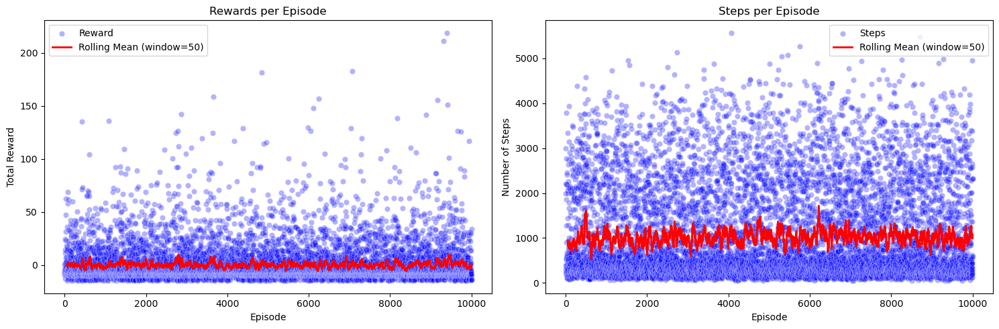


Average result per iteration
Sum of total rewards = 3950.3000000000065
Average total reward per episode = 0.39503000000000005
Average steps per episode = 1009.8669666666666


--------------------Hyperparameters alpha = 0.1, gamma = 0.99--------------------


100%|██████████| 10000/10000 [08:49<00:00, 18.88it/s]


At iteration 1
State-size = 834
Sum of total rewards = -5278.699999999982
Average total reward per episode = -0.5278699999999998
Average steps per episode = 1008.6943


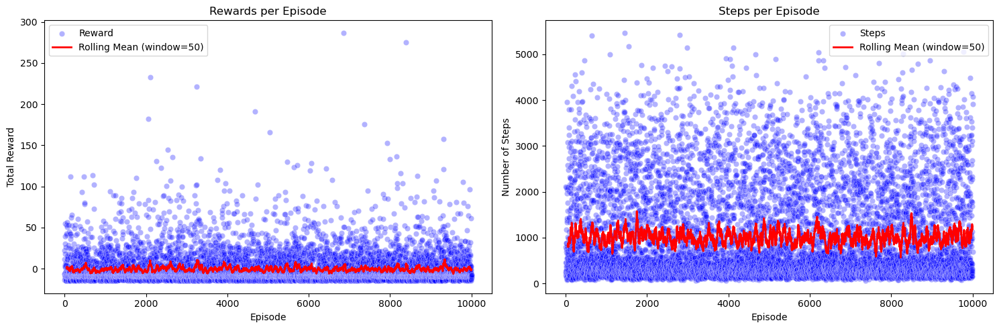

100%|██████████| 10000/10000 [09:23<00:00, 17.74it/s]


At iteration 2
State-size = 889
Sum of total rewards = -1602.9000000000024
Average total reward per episode = -0.16028999999999996
Average steps per episode = 995.0846


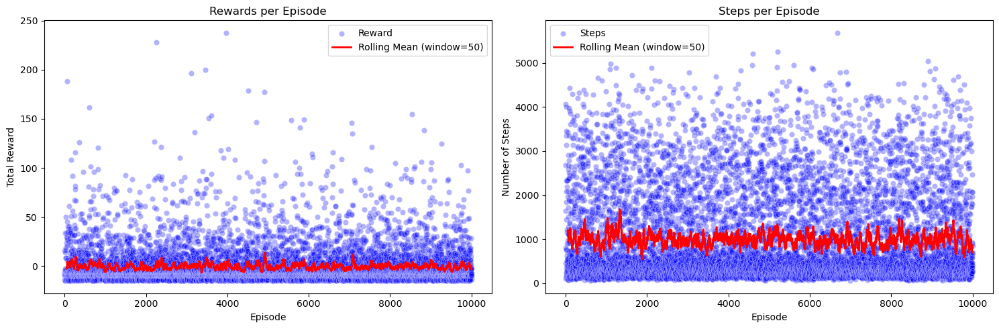

100%|██████████| 10000/10000 [10:44<00:00, 15.51it/s]


At iteration 3
State-size = 865
Sum of total rewards = -5899.500000000023
Average total reward per episode = -0.5899500000000001
Average steps per episode = 1019.9088


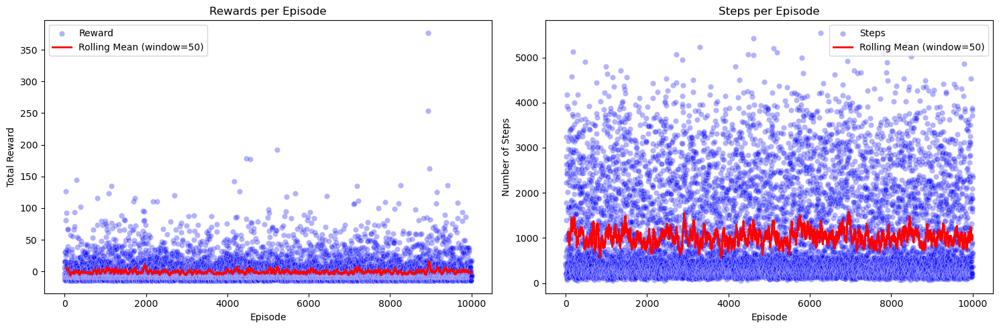


Average result per iteration
Sum of total rewards = -4260.366666666669
Average total reward per episode = -0.4260366666666666
Average steps per episode = 1007.8959


TypeError: 'float' object is not iterable

In [65]:
# SARSA
alpha = [0.1, 0.05, 0.1]
gamma = [0.9, 0.95, 0.99]
for alpha in alpha:
    for gamma in gamma:
        print(f'\n\n--------------------Hyperparameters alpha = {alpha}, gamma = {gamma}--------------------')
        train_model(num_iterations = 3, num_episodes = 10000, on_policy = True, alpha=alpha, epsilon=0.1, lambd=0, gamma=gamma) 


--------------------Hyperparameters alpha = 0.05, gamma = 0.9--------------------


100%|██████████| 10000/10000 [07:48<00:00, 21.37it/s]


At iteration 1
State-size = 572
Sum of total rewards = 5243.199999999994
Average total reward per episode = 0.5243200000000001
Average steps per episode = 1003.5635


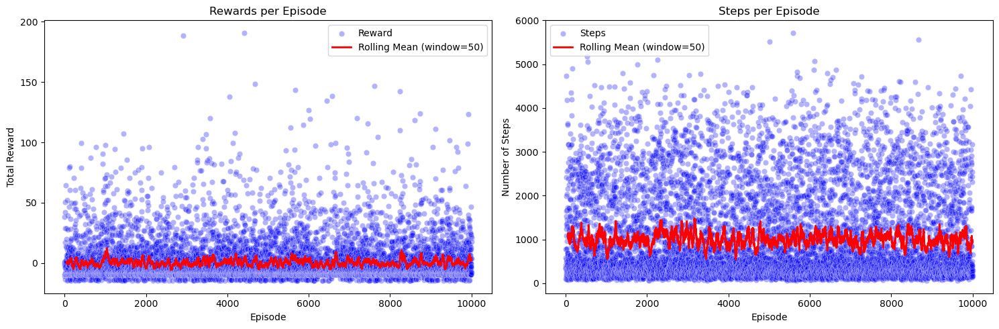


Average result per iteration
Sum of total rewards = 5243.199999999994
Average total reward per episode = 0.5243200000000001
Average steps per episode = 1003.5635

--------------------Hyperparameters alpha = 0.05, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:36<00:00, 25.22it/s]


At iteration 1
State-size = 653
Sum of total rewards = 1910.1999999999896
Average total reward per episode = 0.19102000000000005
Average steps per episode = 1024.0153


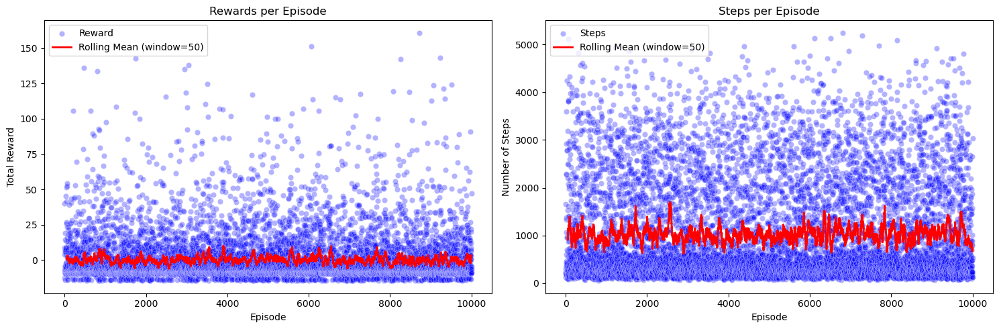


Average result per iteration
Sum of total rewards = 1910.1999999999896
Average total reward per episode = 0.19102000000000005
Average steps per episode = 1024.0153

--------------------Hyperparameters alpha = 0.05, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:36<00:00, 25.23it/s]


At iteration 1
State-size = 762
Sum of total rewards = -3004.7999999999884
Average total reward per episode = -0.30048
Average steps per episode = 1024.0951


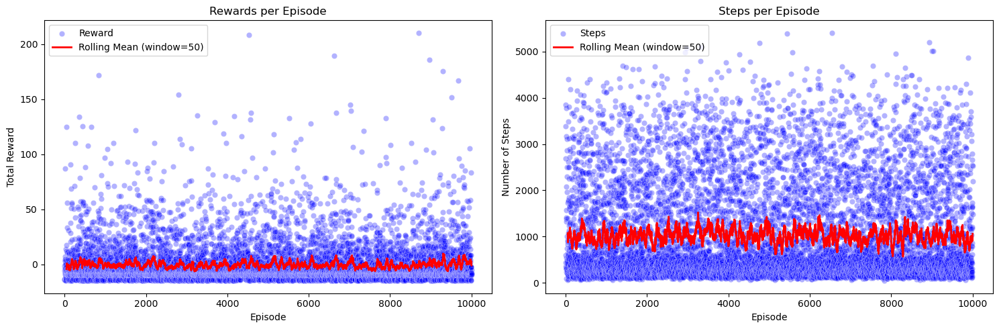


Average result per iteration
Sum of total rewards = -3004.7999999999884
Average total reward per episode = -0.30048
Average steps per episode = 1024.0951

--------------------Hyperparameters alpha = 0.01, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:31<00:00, 25.52it/s]


At iteration 1
State-size = 579
Sum of total rewards = 8295.400000000003
Average total reward per episode = 0.8295399999999999
Average steps per episode = 1021.9776


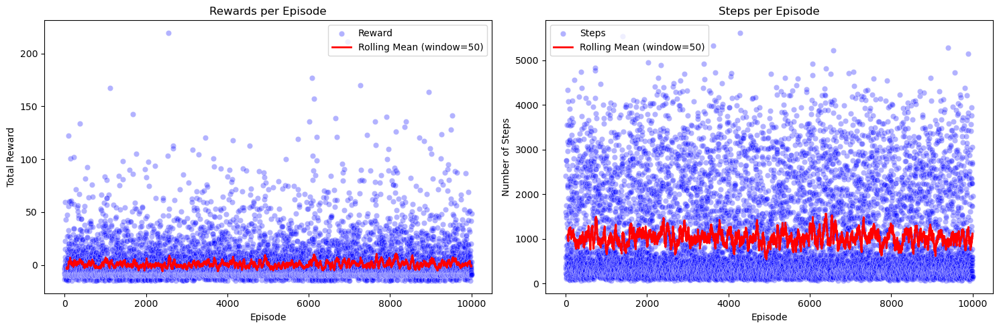


Average result per iteration
Sum of total rewards = 8295.400000000003
Average total reward per episode = 0.8295399999999999
Average steps per episode = 1021.9776

--------------------Hyperparameters alpha = 0.01, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:36<00:00, 25.23it/s]


At iteration 1
State-size = 626
Sum of total rewards = 6197.200000000008
Average total reward per episode = 0.61972
Average steps per episode = 1032.8173


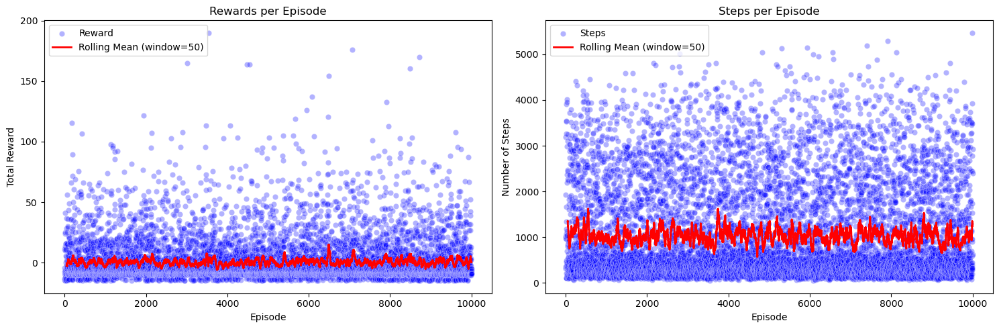


Average result per iteration
Sum of total rewards = 6197.200000000008
Average total reward per episode = 0.61972
Average steps per episode = 1032.8173

--------------------Hyperparameters alpha = 0.01, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:38<00:00, 25.12it/s]


At iteration 1
State-size = 667
Sum of total rewards = -835.699999999999
Average total reward per episode = -0.08356999999999999
Average steps per episode = 1030.6771


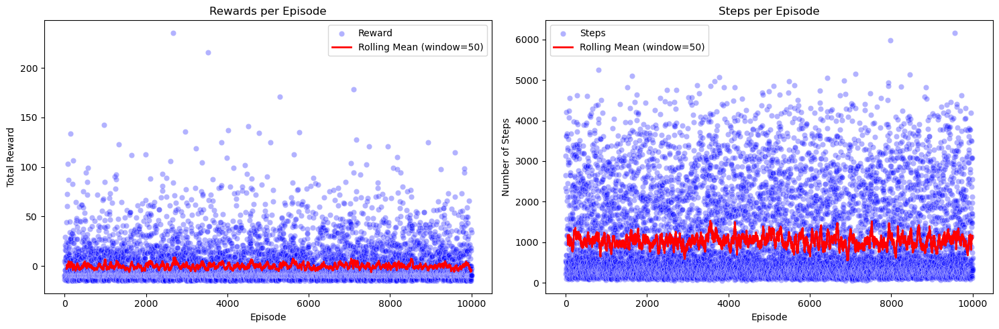


Average result per iteration
Sum of total rewards = -835.699999999999
Average total reward per episode = -0.08356999999999999
Average steps per episode = 1030.6771


In [70]:
# SARSA
alpha_values = [0.05, 0.01]
gamma_values = [0.9, 0.95, 0.99]
for alpha in alpha_values:
    for gamma in gamma_values:
        print(f'\n--------------------Hyperparameters alpha = {alpha}, gamma = {gamma}--------------------')
        train_model(num_iterations = 1, num_episodes = 10000, on_policy = True, alpha=alpha, epsilon=0.1, lambd=0, gamma=gamma) 

#### Q learning


--------------------Hyperparameters alpha = 0.1, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:48<00:00, 24.47it/s]


At iteration 1
State-size = 610
Sum of total rewards = 5006.29999999999
Average total reward per episode = 0.50063
Average steps per episode = 1021.1689


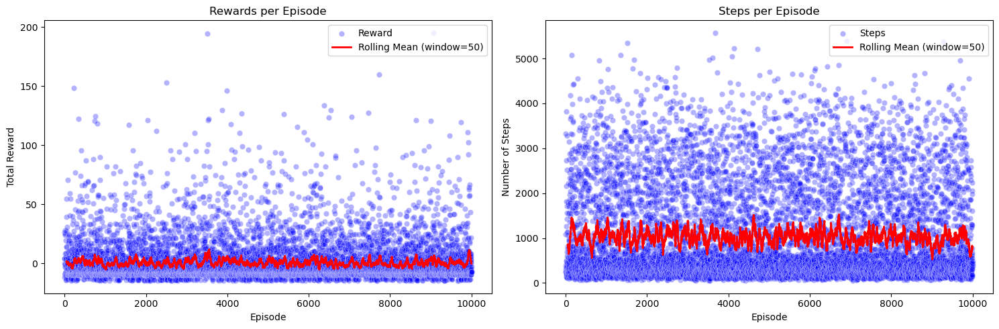


Average result per iteration
Sum of total rewards = 5006.29999999999
Average total reward per episode = 0.50063
Average steps per episode = 1021.1689

--------------------Hyperparameters alpha = 0.1, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:43<00:00, 24.80it/s]


At iteration 1
State-size = 561
Sum of total rewards = 3678.899999999984
Average total reward per episode = 0.36789000000000005
Average steps per episode = 1005.5959


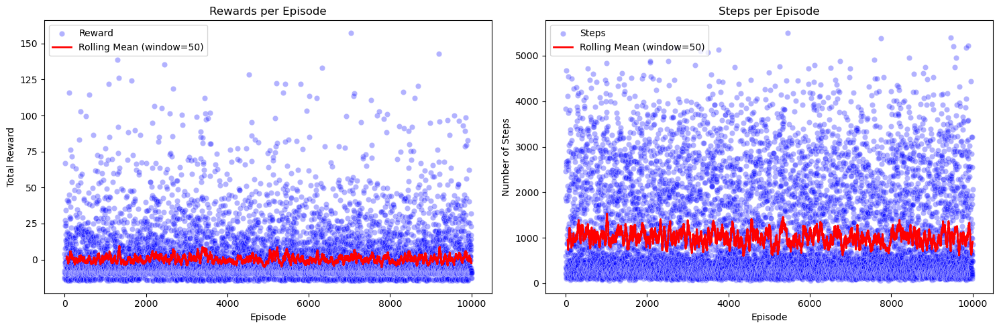


Average result per iteration
Sum of total rewards = 3678.899999999984
Average total reward per episode = 0.36789000000000005
Average steps per episode = 1005.5959

--------------------Hyperparameters alpha = 0.1, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:44<00:00, 24.75it/s]


At iteration 1
State-size = 603
Sum of total rewards = -3284.300000000007
Average total reward per episode = -0.32843
Average steps per episode = 1012.1886


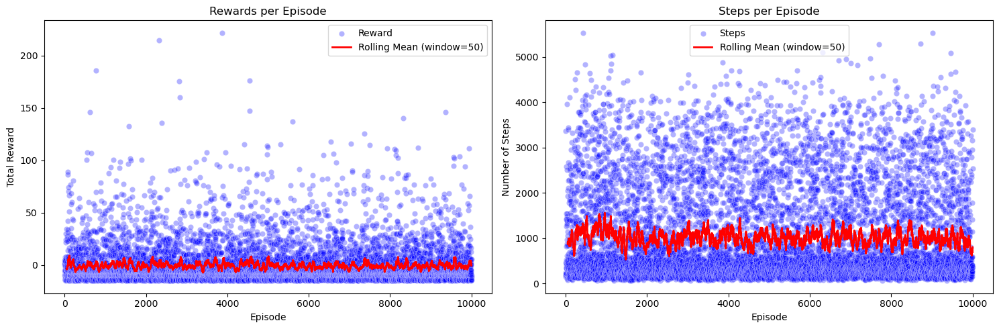


Average result per iteration
Sum of total rewards = -3284.300000000007
Average total reward per episode = -0.32843
Average steps per episode = 1012.1886

--------------------Hyperparameters alpha = 0.05, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:48<00:00, 24.45it/s]


At iteration 1
State-size = 572
Sum of total rewards = 7191.299999999948
Average total reward per episode = 0.7191299999999999
Average steps per episode = 1026.1802


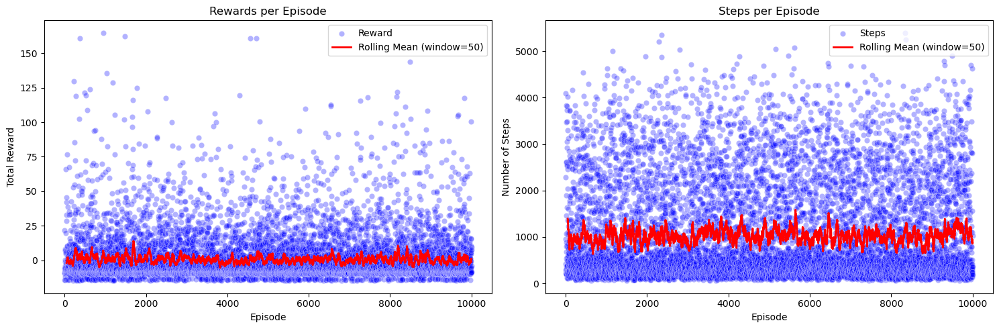


Average result per iteration
Sum of total rewards = 7191.299999999948
Average total reward per episode = 0.7191299999999999
Average steps per episode = 1026.1802

--------------------Hyperparameters alpha = 0.05, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:54<00:00, 24.10it/s]


At iteration 1
State-size = 609
Sum of total rewards = 2203.399999999998
Average total reward per episode = 0.22034000000000006
Average steps per episode = 1038.0743


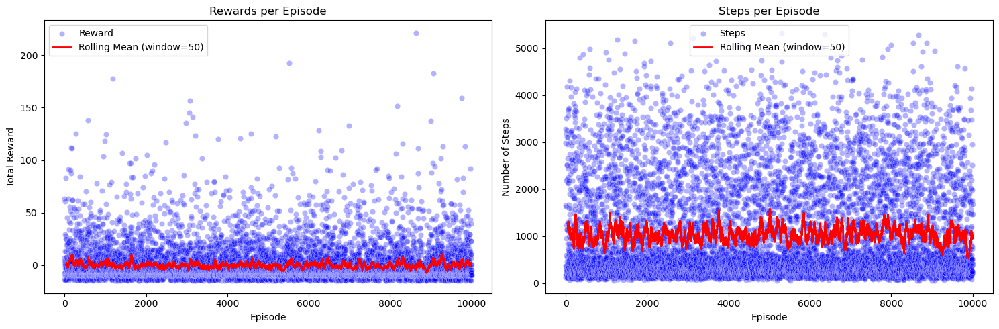


Average result per iteration
Sum of total rewards = 2203.399999999998
Average total reward per episode = 0.22034000000000006
Average steps per episode = 1038.0743

--------------------Hyperparameters alpha = 0.05, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:43<00:00, 24.77it/s]


At iteration 1
State-size = 649
Sum of total rewards = -390.8000000000013
Average total reward per episode = -0.039080000000000024
Average steps per episode = 1016.055


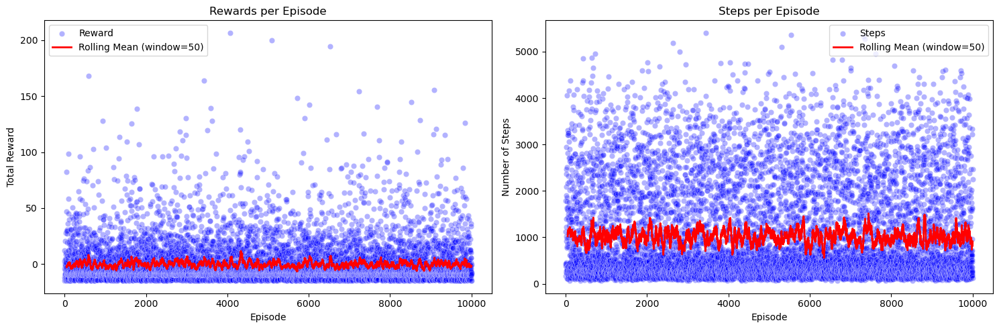


Average result per iteration
Sum of total rewards = -390.8000000000013
Average total reward per episode = -0.039080000000000024
Average steps per episode = 1016.055

--------------------Hyperparameters alpha = 0.01, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:47<00:00, 24.53it/s]


At iteration 1
State-size = 511
Sum of total rewards = 11603.399999999989
Average total reward per episode = 1.1603400000000001
Average steps per episode = 1025.7422


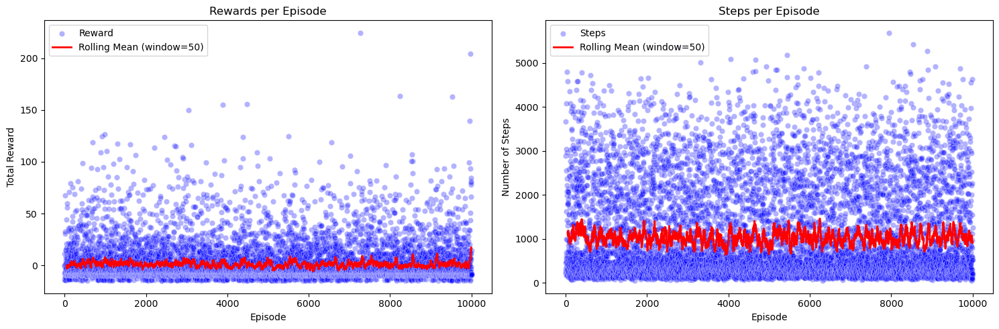


Average result per iteration
Sum of total rewards = 11603.399999999989
Average total reward per episode = 1.1603400000000001
Average steps per episode = 1025.7422

--------------------Hyperparameters alpha = 0.01, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:55<00:00, 24.07it/s]


At iteration 1
State-size = 550
Sum of total rewards = 4647.599999999985
Average total reward per episode = 0.46475999999999995
Average steps per episode = 1044.8732


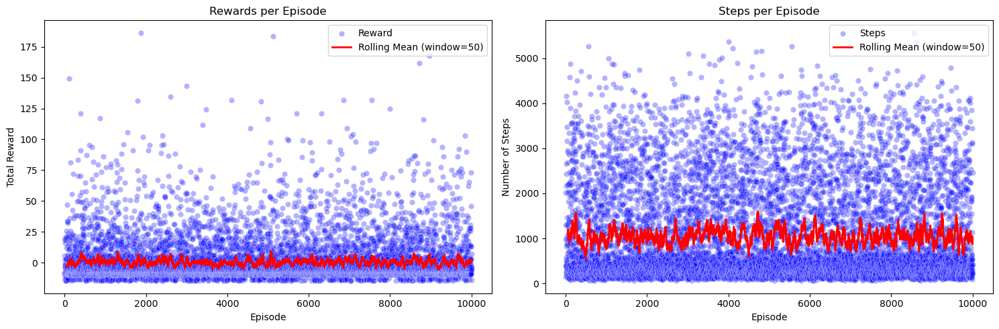


Average result per iteration
Sum of total rewards = 4647.599999999985
Average total reward per episode = 0.46475999999999995
Average steps per episode = 1044.8732

--------------------Hyperparameters alpha = 0.01, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:49<00:00, 24.41it/s]


At iteration 1
State-size = 684
Sum of total rewards = -585.4000000000015
Average total reward per episode = -0.05853999999999999
Average steps per episode = 1024.5947


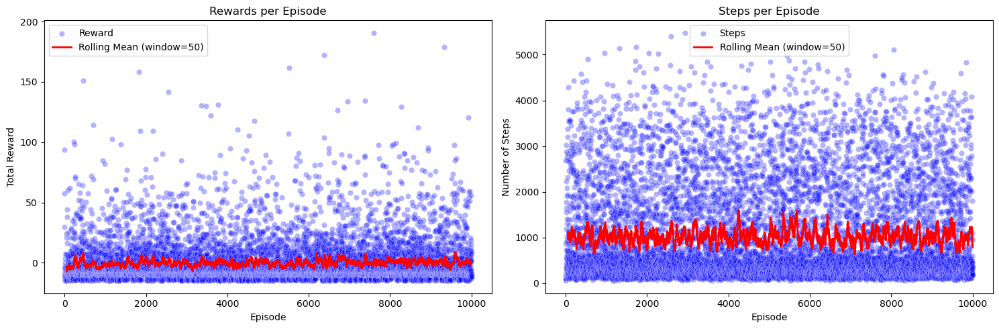


Average result per iteration
Sum of total rewards = -585.4000000000015
Average total reward per episode = -0.05853999999999999
Average steps per episode = 1024.5947


In [71]:
# Q-learning
alpha_values = [0.1, 0.05, 0.01]
gamma_values = [0.9, 0.95, 0.99]
for alpha in alpha_values:
    for gamma in gamma_values:
        print(f'\n--------------------Hyperparameters alpha = {alpha}, gamma = {gamma}--------------------')
        train_model(num_iterations = 1, num_episodes = 10000, on_policy = False, alpha=alpha, epsilon=0.1, lambd=0, gamma=gamma) 

#### Monte Carlo


--------------------Hyperparameters alpha = 0.1, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:39<00:00, 25.03it/s]


At iteration 1
State-size = 396
Sum of total rewards = -2684.299999999985
Average total reward per episode = -0.26843
Average steps per episode = 1022.7869


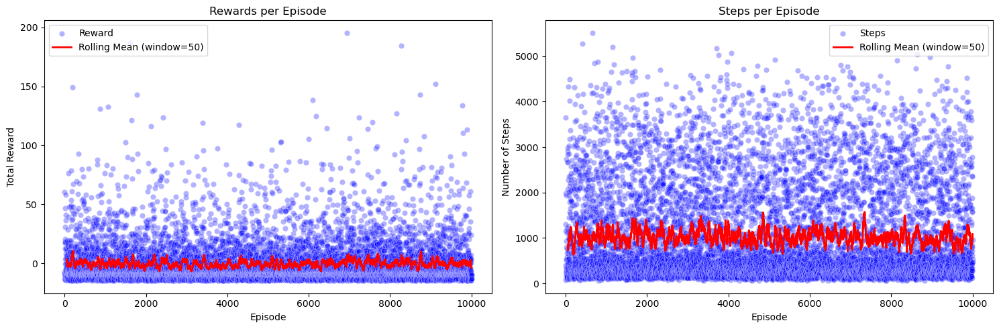


Average result per iteration
Sum of total rewards = -2684.299999999985
Average total reward per episode = -0.26843
Average steps per episode = 1022.7869

--------------------Hyperparameters alpha = 0.1, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:42<00:00, 24.85it/s]


At iteration 1
State-size = 351
Sum of total rewards = -5887.300000000026
Average total reward per episode = -0.58873
Average steps per episode = 1030.1145


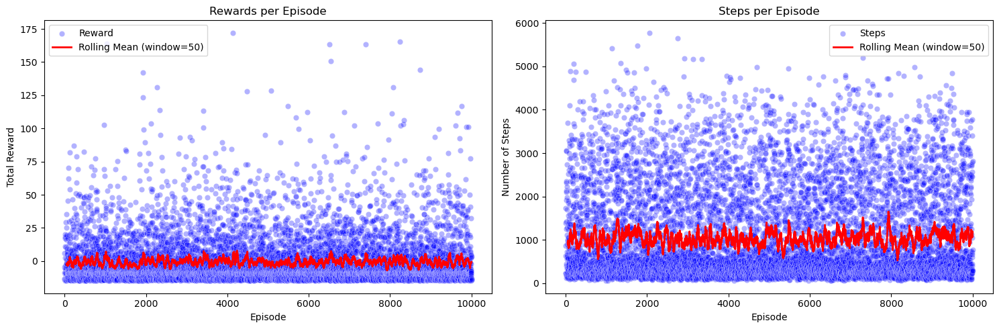


Average result per iteration
Sum of total rewards = -5887.300000000026
Average total reward per episode = -0.58873
Average steps per episode = 1030.1145

--------------------Hyperparameters alpha = 0.1, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:49<00:00, 24.40it/s]


At iteration 1
State-size = 279
Sum of total rewards = -13893.900000000023
Average total reward per episode = -1.3893899999999997
Average steps per episode = 1049.6857


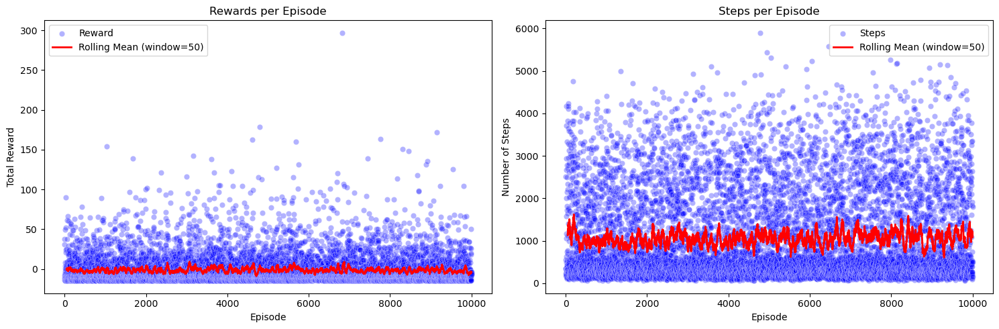


Average result per iteration
Sum of total rewards = -13893.900000000023
Average total reward per episode = -1.3893899999999997
Average steps per episode = 1049.6857

--------------------Hyperparameters alpha = 0.05, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:36<00:00, 25.22it/s]


At iteration 1
State-size = 355
Sum of total rewards = 3611.2000000000075
Average total reward per episode = 0.36112000000000005
Average steps per episode = 1015.1196


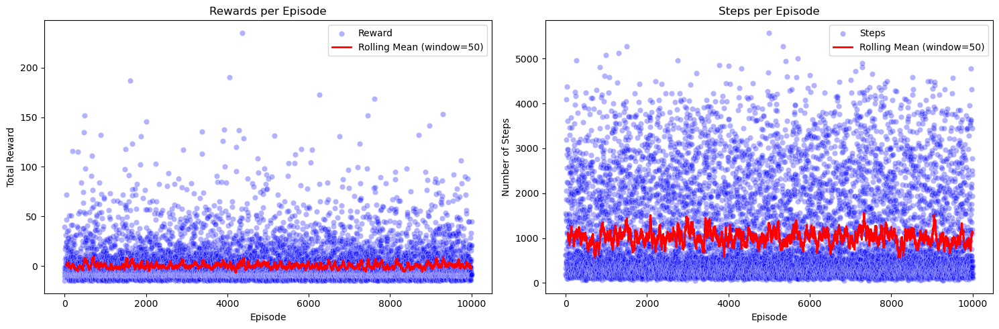


Average result per iteration
Sum of total rewards = 3611.2000000000075
Average total reward per episode = 0.36112000000000005
Average steps per episode = 1015.1196

--------------------Hyperparameters alpha = 0.05, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:48<00:00, 24.48it/s]


At iteration 1
State-size = 339
Sum of total rewards = -1546.100000000001
Average total reward per episode = -0.15460999999999994
Average steps per episode = 1046.4519


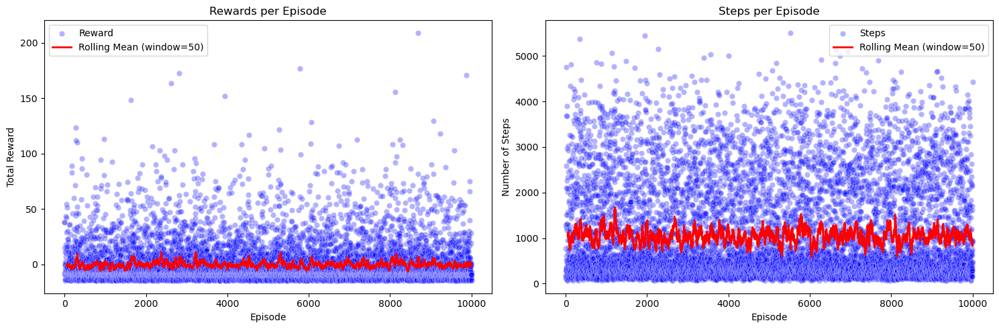


Average result per iteration
Sum of total rewards = -1546.100000000001
Average total reward per episode = -0.15460999999999994
Average steps per episode = 1046.4519

--------------------Hyperparameters alpha = 0.05, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:49<00:00, 24.41it/s]


At iteration 1
State-size = 302
Sum of total rewards = -11923.699999999933
Average total reward per episode = -1.1923700000000002
Average steps per episode = 1047.9036


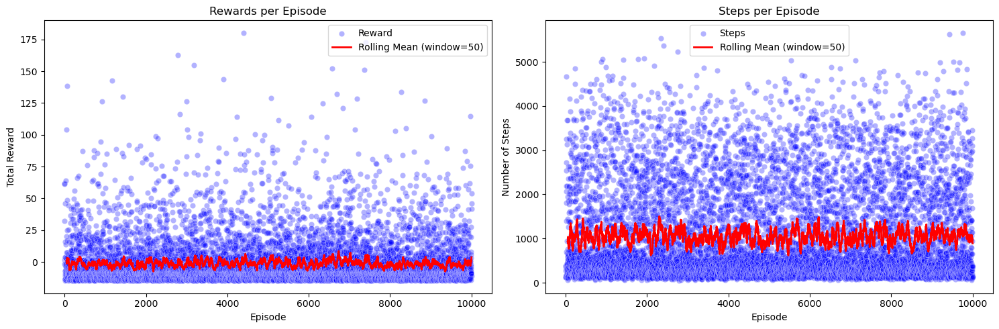


Average result per iteration
Sum of total rewards = -11923.699999999933
Average total reward per episode = -1.1923700000000002
Average steps per episode = 1047.9036

--------------------Hyperparameters alpha = 0.01, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:45<00:00, 24.68it/s]


At iteration 1
State-size = 304
Sum of total rewards = 9492.49999999998
Average total reward per episode = 0.94925
Average steps per episode = 1040.3082


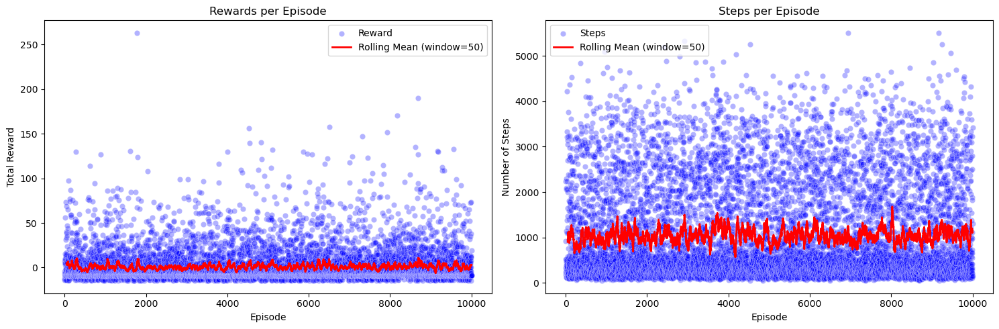


Average result per iteration
Sum of total rewards = 9492.49999999998
Average total reward per episode = 0.94925
Average steps per episode = 1040.3082

--------------------Hyperparameters alpha = 0.01, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:58<00:00, 23.88it/s]


At iteration 1
State-size = 366
Sum of total rewards = 1473.4000000000055
Average total reward per episode = 0.14734
Average steps per episode = 1071.5257


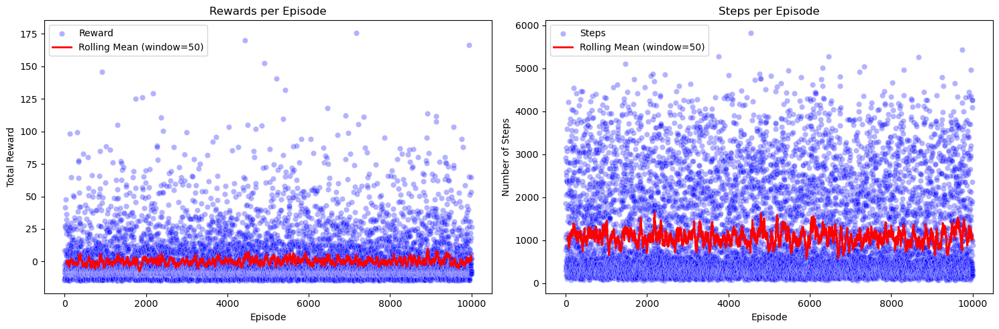


Average result per iteration
Sum of total rewards = 1473.4000000000055
Average total reward per episode = 0.14734
Average steps per episode = 1071.5257

--------------------Hyperparameters alpha = 0.01, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:56<00:00, 24.01it/s]


At iteration 1
State-size = 278
Sum of total rewards = -5106.000000000014
Average total reward per episode = -0.5105999999999999
Average steps per episode = 1068.4214


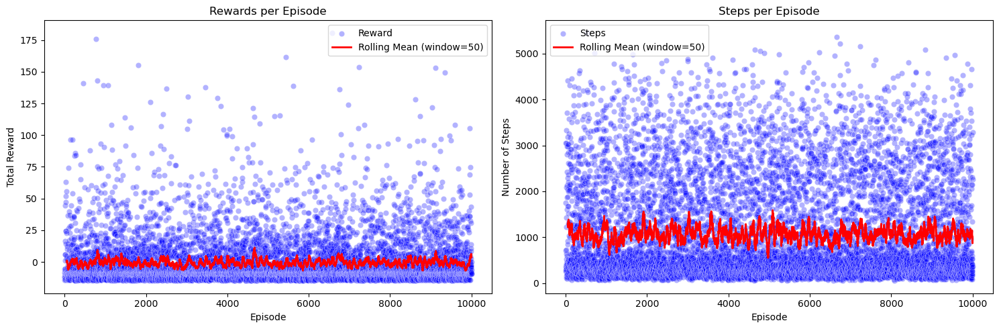


Average result per iteration
Sum of total rewards = -5106.000000000014
Average total reward per episode = -0.5105999999999999
Average steps per episode = 1068.4214


In [72]:
# MC with SARSA
alpha_values = [0.1, 0.05, 0.01]
gamma_values = [0.9, 0.95, 0.99]
for alpha in alpha_values:
    for gamma in gamma_values:
        print(f'\n--------------------Hyperparameters alpha = {alpha}, gamma = {gamma}--------------------')
        train_model(num_iterations = 1, num_episodes = 10000, on_policy = True, alpha=alpha, epsilon=0.1, lambd=1, gamma=gamma) 


--------------------Hyperparameters alpha = 0.1, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:38<00:00, 25.08it/s]


At iteration 1
State-size = 412
Sum of total rewards = 404.09999999999513
Average total reward per episode = 0.04041
Average steps per episode = 1021.8146


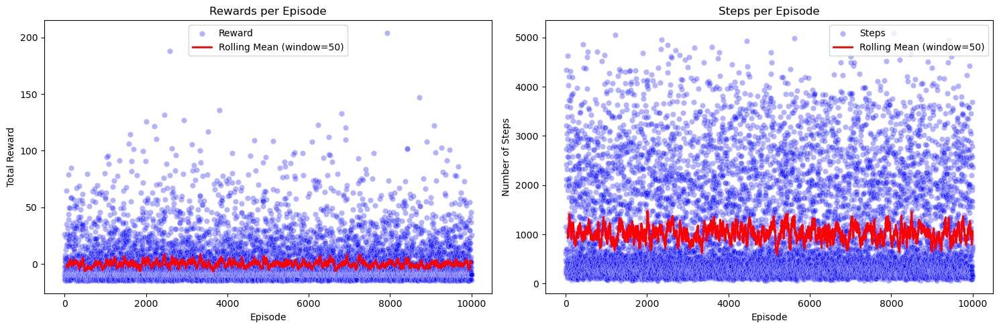


Average result per iteration
Sum of total rewards = 404.09999999999513
Average total reward per episode = 0.04041
Average steps per episode = 1021.8146

--------------------Hyperparameters alpha = 0.1, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:45<00:00, 24.69it/s]


At iteration 1
State-size = 329
Sum of total rewards = -5823.600000000006
Average total reward per episode = -0.58236
Average steps per episode = 1037.9351


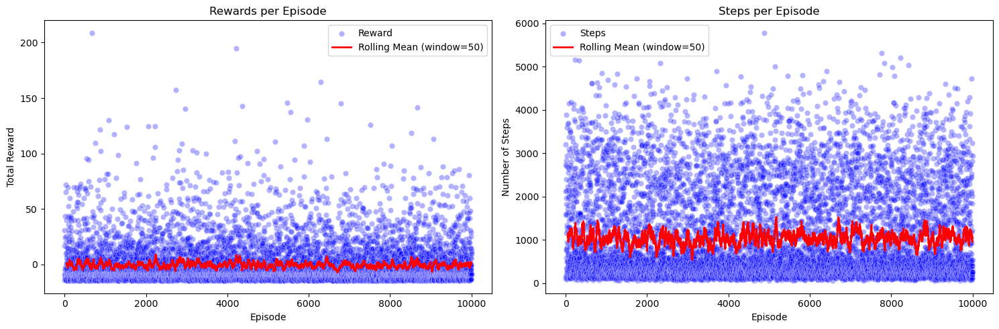


Average result per iteration
Sum of total rewards = -5823.600000000006
Average total reward per episode = -0.58236
Average steps per episode = 1037.9351

--------------------Hyperparameters alpha = 0.1, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:53<00:00, 24.16it/s]


At iteration 1
State-size = 280
Sum of total rewards = -14587.499999999982
Average total reward per episode = -1.45875
Average steps per episode = 1060.1312


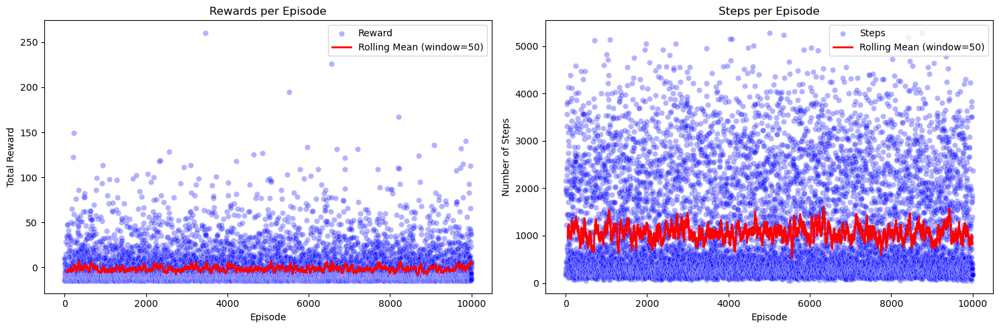


Average result per iteration
Sum of total rewards = -14587.499999999982
Average total reward per episode = -1.45875
Average steps per episode = 1060.1312

--------------------Hyperparameters alpha = 0.05, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:42<00:00, 24.83it/s]


At iteration 1
State-size = 346
Sum of total rewards = 4588.0999999999985
Average total reward per episode = 0.45880999999999994
Average steps per episode = 1032.832


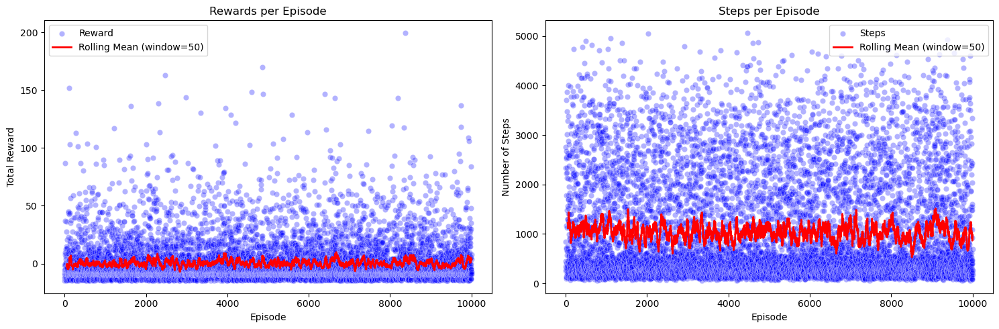


Average result per iteration
Sum of total rewards = 4588.0999999999985
Average total reward per episode = 0.45880999999999994
Average steps per episode = 1032.832

--------------------Hyperparameters alpha = 0.05, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:43<00:00, 24.77it/s]


At iteration 1
State-size = 330
Sum of total rewards = -4326.100000000038
Average total reward per episode = -0.43261000000000005
Average steps per episode = 1035.015


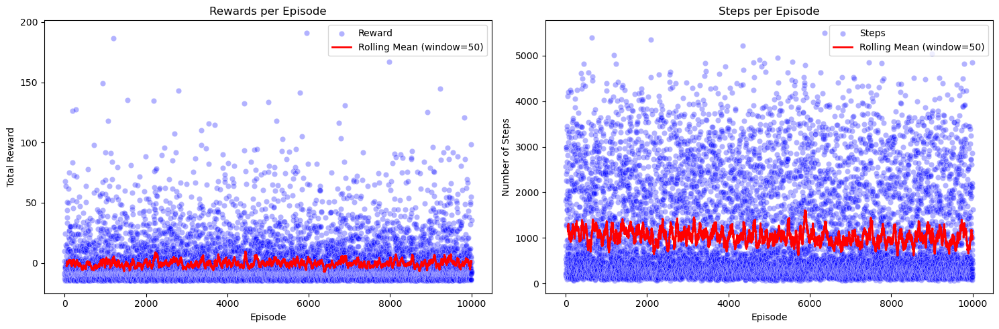


Average result per iteration
Sum of total rewards = -4326.100000000038
Average total reward per episode = -0.43261000000000005
Average steps per episode = 1035.015

--------------------Hyperparameters alpha = 0.05, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:51<00:00, 24.32it/s]


At iteration 1
State-size = 269
Sum of total rewards = -9816.999999999978
Average total reward per episode = -0.9817
Average steps per episode = 1052.5619


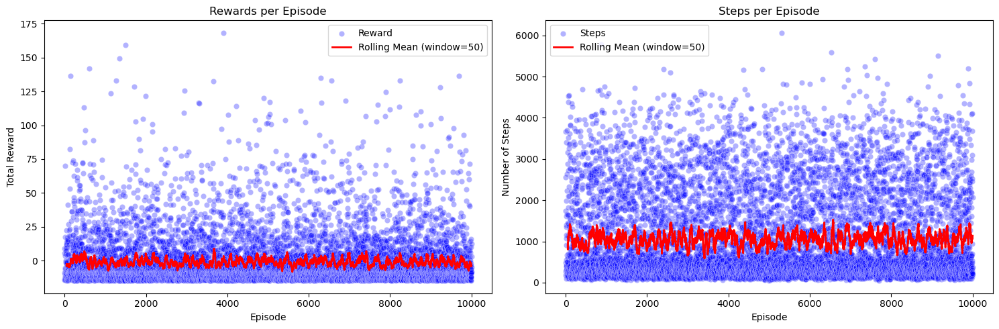


Average result per iteration
Sum of total rewards = -9816.999999999978
Average total reward per episode = -0.9817
Average steps per episode = 1052.5619

--------------------Hyperparameters alpha = 0.01, gamma = 0.9--------------------


100%|██████████| 10000/10000 [06:39<00:00, 25.01it/s]


At iteration 1
State-size = 366
Sum of total rewards = 5520.9999999999945
Average total reward per episode = 0.5521
Average steps per episode = 1025.4824


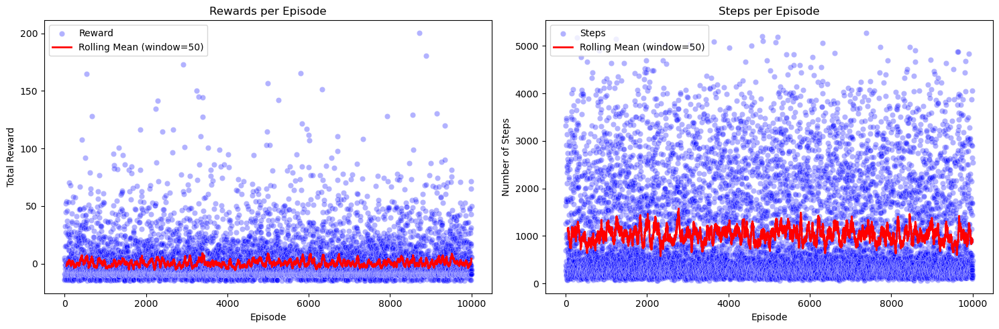


Average result per iteration
Sum of total rewards = 5520.9999999999945
Average total reward per episode = 0.5521
Average steps per episode = 1025.4824

--------------------Hyperparameters alpha = 0.01, gamma = 0.95--------------------


100%|██████████| 10000/10000 [06:50<00:00, 24.35it/s]


At iteration 1
State-size = 334
Sum of total rewards = -166.69999999999985
Average total reward per episode = -0.01666999999999996
Average steps per episode = 1052.1906


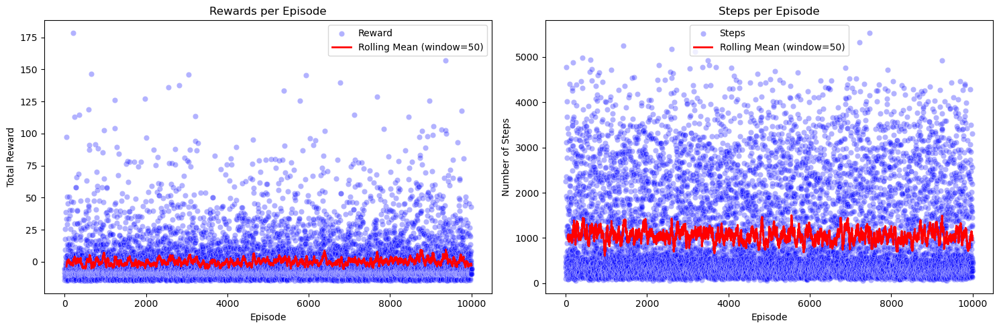


Average result per iteration
Sum of total rewards = -166.69999999999985
Average total reward per episode = -0.01666999999999996
Average steps per episode = 1052.1906

--------------------Hyperparameters alpha = 0.01, gamma = 0.99--------------------


100%|██████████| 10000/10000 [06:57<00:00, 23.97it/s]


At iteration 1
State-size = 270
Sum of total rewards = -5425.300000000012
Average total reward per episode = -0.5425300000000001
Average steps per episode = 1067.2312


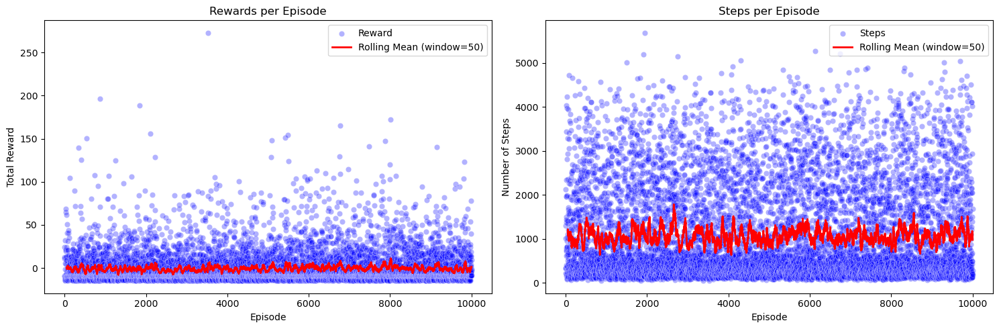


Average result per iteration
Sum of total rewards = -5425.300000000012
Average total reward per episode = -0.5425300000000001
Average steps per episode = 1067.2312


In [73]:
# MC with SARSA
alpha_values = [0.1, 0.05, 0.01]
gamma_values = [0.9, 0.95, 0.99]
for alpha in alpha_values:
    for gamma in gamma_values:
        print(f'\n--------------------Hyperparameters alpha = {alpha}, gamma = {gamma}--------------------')
        train_model(num_iterations = 1, num_episodes = 10000, on_policy = False, alpha=alpha, epsilon=0.1, lambd=1, gamma=gamma) 

#### TD(lambda)


--------------------Hyperparameters alpha = 0.1, gamma = 0.9, lambda = 0.5 --------------------


100%|██████████| 10000/10000 [2:06:30<00:00,  1.32it/s] 


At iteration 1
State-size = 553
Sum of total rewards = 4563.899999999987
Average total reward per episode = 0.4563900000000001
Average steps per episode = 1006.3811


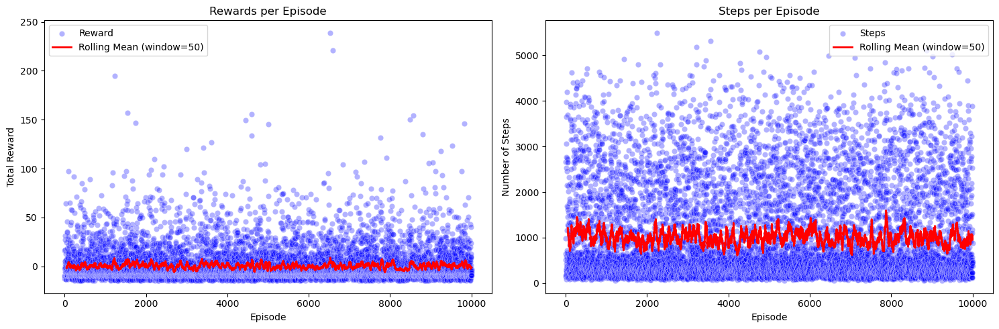


Average result per iteration
Sum of total rewards = 4563.899999999987
Average total reward per episode = 0.4563900000000001
Average steps per episode = 1006.3811

--------------------Hyperparameters alpha = 0.1, gamma = 0.9, lambda = 0.8 --------------------


100%|██████████| 10000/10000 [2:18:46<00:00,  1.20it/s] 


At iteration 1
State-size = 444
Sum of total rewards = 3004.599999999978
Average total reward per episode = 0.30046000000000006
Average steps per episode = 1036.7532


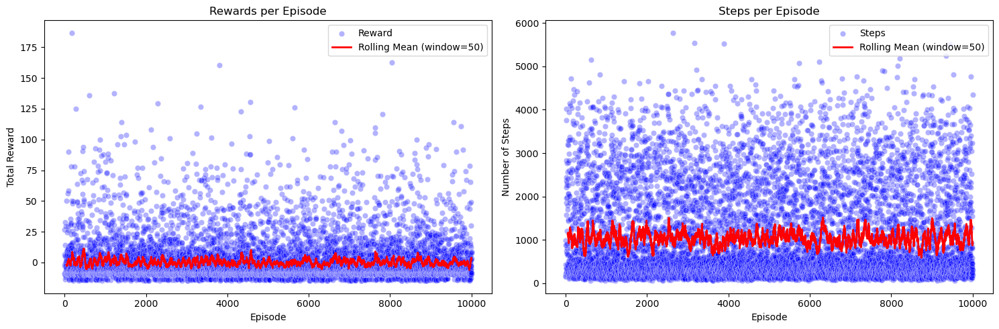


Average result per iteration
Sum of total rewards = 3004.599999999978
Average total reward per episode = 0.30046000000000006
Average steps per episode = 1036.7532


In [74]:
# TD(lambda)
lambd_values = [0.5, 0.8]
alpha = 0.1
gamma = 0.9
for lambd in lambd_values:
    print(f'\n--------------------Hyperparameters alpha = {alpha}, gamma = {gamma}, lambda = {lambd} --------------------')
    train_model(num_iterations = 1, num_episodes = 10000, on_policy = False, alpha=alpha, epsilon=0.1, lambd=lambd, gamma=gamma) 

##### **Evaluation**

In [ ]:
best_Q = sarsa.Q

In [85]:
file_path = "Q_val__TD_lambd_0.8.json"
save_q_val(file_path, best_Q)

In [92]:
#get statistics for 'best' action
left = 0
stay = 0
right = 0
for key, val in best_Q.items():
    action = np.argmax(val)
    if action == 0:
        left += 1
    elif action == 1:
        stay += 1
    else:
        right += 1

print(f"Count for action = left = {left}")
print(f"Count for action = stay = {stay}")
print(f"Count for action = right = {right}")

Count for action = left = 226
Count for action = stay = 69
Count for action = right = 64
